# Generating Simplified Floodmap using Global Data

In this notebook, we create a simplified compound flood map that combines coastal and fluvial flooding using both the bathtub method and Height Above Nearest Drainage (HAND). While we demonstrate the approach with global data in this example, it's also possible to apply the same methodology with local data.

## Data Requirements

To achieve our goal, we require four critical datasets:

1. **Digital Elevation Model (MERIT)**
   - A state-of-the-art global DEM map with a resolution of 90x90 meters.
   - Derived from the latest elevation data (MERIT DEM) and incorporates valuable information from water body datasets such as G1WBM, GSWO, and OpenStreetMap. This dataset is the preferred global DEM for modeling, as it includes the identification of rivers, water basins, and corrections for errors in the input elevation data.
   - MERITHydro encompasses both elevation and HAND (Height Above Nearest Drainage), which are crucial for modeling coastal and fluvial floods.
   - http://hydro.iis.u-tokyo.ac.jp/~yamadai/MERIT_Hydro/

2. **Land Subsidence Rate (BBWS Semarang)**
   - This dataset was collected specifically between 2015 and 2018.
   - It quantifies land subsidence in millimeters and exhibits spatial variability within the study area.

3. **Total Rainfall (Meter Total for the Event Period)**
   - The rainfall height for the defined event period (ERA5) is acquired in our previous analysis.
   - The volume of fluvial flooding will be derived using the rational method.
   - https://cds.climate.copernicus.eu/cdsapp#!/dataset/reanalysis-era5-single-levels?tab=overview

4. **Maximum Water Level (m+MSL for the Event Period)**
   - In our previous analysis, the maximum water level during the defined event period (GTSM) is obtained.
   - This parameter serves as the primary driver for coastal flooding.
   - https://publicwiki.deltares.nl/display/GTSM/Global+Tide+and+Surge+Model


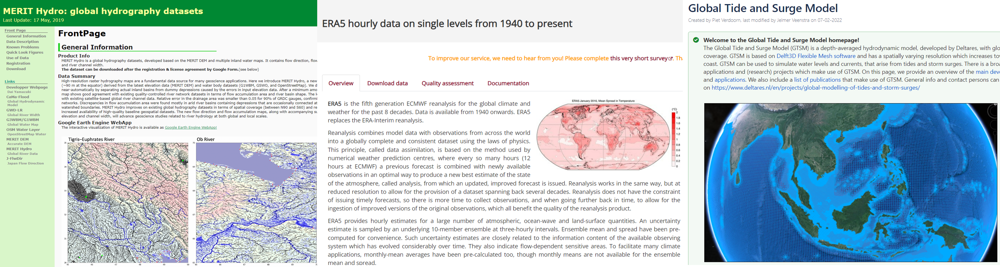

# Flood drivers
There will be 3 important drivers for compound flooding
- Land subsidence: Lower elevation over the year
- Fluvial flood: Climate change, higher rainfall intensity
- Coastal flood: Climate change, sea level rise

# Importing Python libraries

Libraries consist of pre-written code and functions created by other developers. Libraries are collections of modules and functions that provide specific functionality. In this notebook, these libraries will be used:
-  opening various types of data files: pandas, netcdf, pathlib
- general-purpose data manipulation and handling: xarray, pandas, time, num
- data visualization: Matplotlib and Bokeh, with the ability to display interactive plots directly in the Jupyter Notebook.

In [19]:
# Importing the packages, first time this can take a while (eg 20sec)

import xarray as xr
import pandas as pd
import numpy as np
import pathlib
from pysheds.grid import Grid
import rasterio
import matplotlib.pyplot as plt

from bokeh.layouts import column
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource, CustomJS, Slider
from bokeh.models import LinearColorMapper, ColorBar
from bokeh.io import output_notebook

output_notebook()

Loading BokehJS ...

In [12]:
#input data you get from previous code
#forcing=============================================================
P = 0.082 #total rainfall over a period in meter
coeff = 0.83 #infiltration coefficent whole area
h =  0.55 #in m
event_id = "6"

In [13]:
# Define the path to the data folder
base_path = r"C:/Users/micha/Stichting Deltares/Tiaravanni Hermawan - Indonesia case for students"
data_path = "semarang/for_cindy/hydromt/"

data_folder = pathlib.Path(base_path, data_path)

In [14]:
# Retrieving and preparing the data
elevation = "elevation_wgs84_cleaned.tiff"
elevation_data = pathlib.Path(data_folder, elevation)
grid = Grid.from_raster(elevation_data.as_posix())
dem = np.flipud(grid.read_raster(elevation_data.as_posix()))
dem[dem < 0] = np.nan
dem_view = grid.view(dem, nodata=np.nan)


In [15]:
# Utils

def wgs84_to_web_mercator(lat, lon):
    # Function to convert to mercator for Bokeh use
    k = 6378137
    x = lon * (k * np.pi/180.0)
    y = np.log(np.tan((90 + lat) * np.pi/360.0)) * k
    return x, y


<!-- TODO: add some text for context -->

Visualizing the elevation map of the area.

In [16]:
# Retrieving and preparing the data
elevation = "elevtn.tif"
elevation_data = pathlib.Path(data_folder, elevation)
grid = Grid.from_raster(elevation_data.as_posix())
dem = np.flipud(grid.read_raster(elevation_data.as_posix()))
dem[dem < 0] = np.nan
dem_view = grid.view(dem, nodata=np.nan)


def wgs84_to_web_mercator(lat, lon):
    # Function to convert to mercator for Bokeh use
    k = 6378137
    x = lon * (k * np.pi/180.0)
    y = np.log(np.tan((90 + lat) * np.pi/360.0)) * k
    return x, y

TOOLTIPS = [("value", "@image")]

# Setting up the Bokeh figure with a background map
p = figure(x_axis_type="mercator", y_axis_type="mercator", tooltips=TOOLTIPS)
p.add_tile("CartoDB Positron", retina=True)

# Setting the extent in mercator coordinates
gridl1 = wgs84_to_web_mercator(grid.extent[2], grid.extent[0])
gridl2 = wgs84_to_web_mercator(grid.extent[3], grid.extent[1])

# Creating an image of the DEM data
source = ColumnDataSource(data=dict(image=[dem_view]))
dem_image = p.image(
    image='image',
    source=source,
    x=gridl1[0],
    y=gridl1[1],
    dw=gridl2[0] - gridl1[0],
    dh=gridl2[1] - gridl1[1],
    palette="Spectral11",
    alpha=0.5
)
# Create a color bar from the scatter glyph renderer
color_bar = dem_image.construct_color_bar(width=10)
p.add_layout(color_bar, 'right')

show(p)

# Land subsidence

Land subsidence may significantly alter flood patterns within cities. The rate of subsidence may change spatial distribution in fluvial floods and poses a heightened risk for coastal flooding.

It's important to note that this scenario serves as an illustrative example. For more accurate assessments, a locally updated version of the Digital Elevation Model (DEM) is recommended. To simulate flood in 2020, the Merit DEM (generated in 2000) requires 20 years of land subsidence adjustments. To maintain simplicity, a linear annual subsidence rate over these two decades are assumped. However, this assumption may oversimplify the real-world situation.

For instance, the changes in some points in the Siangker basin may reaches 3 meters, where the subsidence rate is estimated at 15 cm per year, the total change over 20 years. Such a significant figure might seem unrealistic, given that governmental measures, like groundwater abstraction controls, would likely have been implemented to mitigate this issue. However, for the purposes of this exercise, we can proceed with these assumptions.

The map below visually represents how elevations have changed over time due to the substantial subsidence, especially in areas with exceptionally high rates.rates.

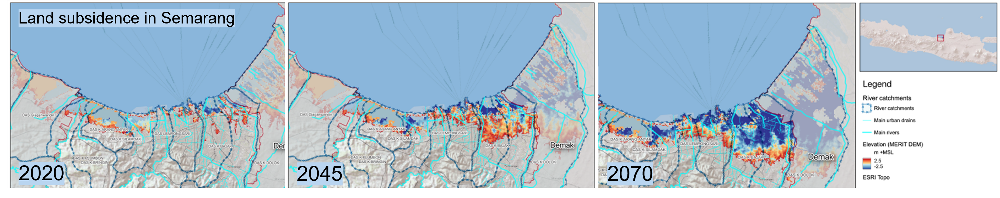

In [22]:
palette = ('rgba(11,6,17,1)',
            'rgba(154,25,25,1)',
            'rgba(255,255,255,1)',
            'rgba(255,250,222,1)',
            'rgba(255,246,199,1)',
            'rgba(255,242,172,1)',
            'rgba(255,237,140,1)',
            'rgba(255,232,112,1)',
            'rgba(255,229,96,1)',
            'rgba(255,226,79,1)',
            'rgba(255,225,70,1)',
            'rgba(255,223,56,1)',
            'rgba(255,221,46,1)',
            'rgba(240,210,44,1)',
            'rgba(209,187,39,1)',
            'rgba(189,172,36,1)',
            'rgba(152,145,31,1)',
            'rgba(133,131,28,1)',
            'rgba(113,116,25,1)',
            'rgba(81,92,21,1)',
            'rgba(61,77,18,1)',
            'rgba(61,77,18,1)',
            'rgba(6,37,10,1)'
            )

# Retrieving and preparing the data
elevation = "elevtn_cleaned.tiff"
elevation_data = pathlib.Path(data_folder, elevation)
grid = Grid.from_raster(elevation_data.as_posix())
dem = np.flipud(grid.read_raster(elevation_data.as_posix()))
dem[dem < 0] = 0
dem_view = grid.view(dem, nodata=np.nan)


# Get the data from the land subsidence tif
land_subsidence = "LS_Sem_300_wgs84_cleaned.tiff"
land_subsidence_data = pathlib.Path(data_folder, land_subsidence)
land_subsidence_grid = Grid.from_raster(land_subsidence_data.as_posix())
ls_grid = np.flipud(land_subsidence_grid.read_raster(land_subsidence_data.as_posix()))
ls_view = land_subsidence_grid.view(ls_grid)



TOOLTIPS = [("value", "@image")]
# Setting up the Bokeh figure with a background map

p = figure(x_axis_type="mercator", y_axis_type="mercator", tooltips=TOOLTIPS, width = 800, height = 800)
p.add_tile("CartoDB Positron", retina=True)

# Setting the extent in mercator coordinates
gridl1 = wgs84_to_web_mercator(grid.extent[2], grid.extent[0])
gridl2 = wgs84_to_web_mercator(grid.extent[3], grid.extent[1])



# Creating an image of the DEM data
source = ColumnDataSource(data=dict(image=[dem_view], dem_view=[dem_view], ls_view=[ls_view]))
color = LinearColorMapper(palette = palette, low = -10, high = 100, nan_color='#00000000')
dem_image = p.image(
    image='image',
    source=source,
    x=gridl1[0],
    y=gridl1[1],
    dw=gridl2[0] - gridl1[0],
    dh=gridl2[1] - gridl1[1],
    alpha=0.5,
    level="image",
    color_mapper=color
)
# Create a color bar from the scatter glyph renderer
color_bar = dem_image.construct_color_bar(width=10)
# color_bar = ColorBar(color_mapper = color, location = (0,0))

# Adding callback code
update_image = CustomJS(args=dict(source=source),
                    code="""
    const data = source.data;
    const val = cb_obj.value
    const dem_view = data['dem_view']
    const ls_view = data['ls_view']
    const image = data['image']
    for (let i = 0; i < dem_view[0].length; i++) {
        const subs = ls_view[0][i] || 0
        image[0][i] = dem_view[0][i] + (subs/100. * val)
    }
    source.change.emit()
""")

# Creating the slider to slide through the years
time_slider = Slider(title="Years", start=0, end=50, value=0, step=1)
time_slider.js_on_change('value', update_image)

p.add_layout(color_bar, 'right')

show(column(p, time_slider))

(400, 491) (400, 491)
12261086.093392728 -802823.2252886826 12306729.037383111 -765358.1833000687


In [24]:
floodmaps_palette = ('rgba(4, 59, 92, 1)',
                        'rgba(4, 59, 92, 1)',
                        'rgba(255,255,255,1)',
                        'rgba(255,250,222,1)',
                        'rgba(255,246,199,1)',
                        'rgba(255,242,172,1)',
                        'rgba(255,237,140,1)',
                        'rgba(255,232,112,1)',
                        'rgba(255,229,96,1)',
                        'rgba(255,226,79,1)',
                        'rgba(255,225,70,1)',
                        'rgba(255,223,56,1)',
                        'rgba(255,221,46,1)',
                        'rgba(240,210,44,1)',
                        'rgba(209,187,39,1)',
                        'rgba(189,172,36,1)',
                        'rgba(152,145,31,1)',
                        'rgba(133,131,28,1)',
                        'rgba(113,116,25,1)',
                        'rgba(81,92,21,1)',
                        'rgba(61,77,18,1)',
                        'rgba(61,77,18,1)',
                        'rgba(6,37,10,1)'
            )


# Bathtub: Coastal flood and Elevation
A simple bathtub approach has been used to assess coastal inundation from sea levels. This approach has assumed that a (for example) 1 m rise in sea level will inundate all locations at or below an elevation of 1 m. This approach is a relatively simple and efficient means of identifying areas likely to be at risk.

In [25]:
# Retrieving and preparing the data
elevation = "elevtn_cleaned.tiff"
elevation_data = pathlib.Path(data_folder, elevation)
grid = Grid.from_raster(elevation_data.as_posix())
dem = np.flipud(grid.read_raster(elevation_data.as_posix()))
dem[dem < 0] = np.nan
dem_view = grid.view(dem, no_data=np.nan)

TOOLTIPS = [("value", "@image")]
# Setting up the Bokeh figure with a background map
p = figure(x_axis_type="mercator", y_axis_type="mercator", tooltips=TOOLTIPS, width=800, height=800)
p.add_tile("CartoDB Positron", retina=True)

# Setting the extent in mercator coordinates
gridl1 = wgs84_to_web_mercator(grid.extent[2], grid.extent[0])
gridl2 = wgs84_to_web_mercator(grid.extent[3], grid.extent[1])

# Creating an image of the DEM data
source = ColumnDataSource(data=dict(image=[dem_view], dem_view=[dem_view]))
color = LinearColorMapper(palette = floodmaps_palette, low = -10, high = 100, nan_color='#00000000')
dem_image = p.image(
    image='image',
    source=source,
    x=gridl1[0],
    y=gridl1[1],
    dw=gridl2[0] - gridl1[0],
    dh=gridl2[1] - gridl1[1],
    alpha=0.5,
    level="image",
    color_mapper=color
)
# Create a color bar from the scatter glyph renderer
color_bar = dem_image.construct_color_bar(width=10)
# color_bar = ColorBar(color_mapper = color, location = (0,0))

# Adding callback code
update_image = CustomJS(args=dict(source=source),
                    code="""
    const data = source.data;
    const val = cb_obj.value
    const dem_view = data['dem_view']
    const image = data['image']
    for (let i = 0; i < dem_view[0].length; i++) {
        image[0][i] = val > dem_view[0][i] && dem_view[0][i] ? -10 : dem_view[0][i]
    }
    source.change.emit()
""")

# Creating the slider to slide through the years
time_slider = Slider(title="Height", start=0, end=10, value=0, step=0.1)
time_slider.js_on_change('value', update_image)

p.add_layout(color_bar, 'right')

show(column(p, time_slider))

# HAND: Fluvial flood and Height Above Nearest Drainage

The Height Above Nearest Drainage (HAND) technique is a simplified method for mapping inundation from the river using elevation data, discharge-height correlations, and volume of rainfall. In this approach, river or drainage is 0, while all other pixels are assigned HAND values greater than 0. A higher HAND value signifies a lower likelihood of flooding, while a HAND value closer to 0 indicates a higher likelihood of flooding. These HAND values, derived from the DEM data.

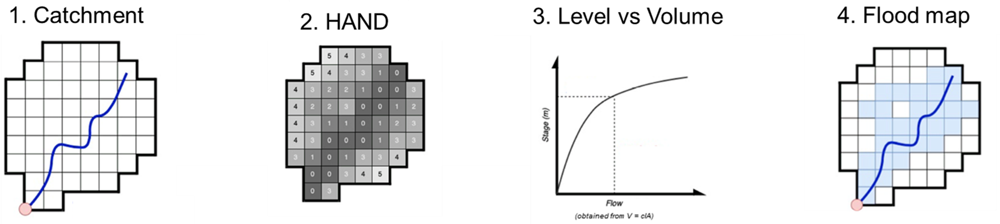


In the event of a fluvial flood, the rational method to estimate the flood volume is employed. This method includes on the land use within the catchment area, which determines the infiltration rate and the flood volume calculation. As the Semarang basins are rather small in size, it is assumed that the rainfall intensity at one point within the basin is representative for the entire catchment.


In [53]:
#FLUVIAL====================================================
#volume based on the precipitation==========================
#masking used is the whole basin, as rainfall falls into the whole area
#Land subsidence scripts
#load elevation data then make slider

elevation = "elevtn_cleaned.tiff"
#Read rater metadata

elev_data = pathlib.Path(base_path, data_path,elevation)
with rasterio.open(elev_data) as src:
    ras_meta = src.profile
    pixel_width, pixel_height = src.res

elevation_map = rasterio.open(elev_data).read(1)

basin_grid = elevation_map.copy()
valid_pixels = np.isfinite(basin_grid)

num_valid_pixels = np.sum(valid_pixels)

total_area_m2 = num_valid_pixels * (pixel_width * pixel_height)
water_volume_Mcm = total_area_m2 * P / 10.**6 * coeff
print ("water volume in Mcm is " + str(water_volume_Mcm))

water volume in Mcm is 7.91026934415299e-09


In [31]:
hand = "hnd_cleaned.tiff"
#Read raster metadata

hand_data = pathlib.Path(base_path, data_path,hand)
with rasterio.open(hand_data) as src:
    ras_meta = src.profile
    pixel_width, pixel_height = src.res

hand_map = rasterio.open(hand_data).read(1)

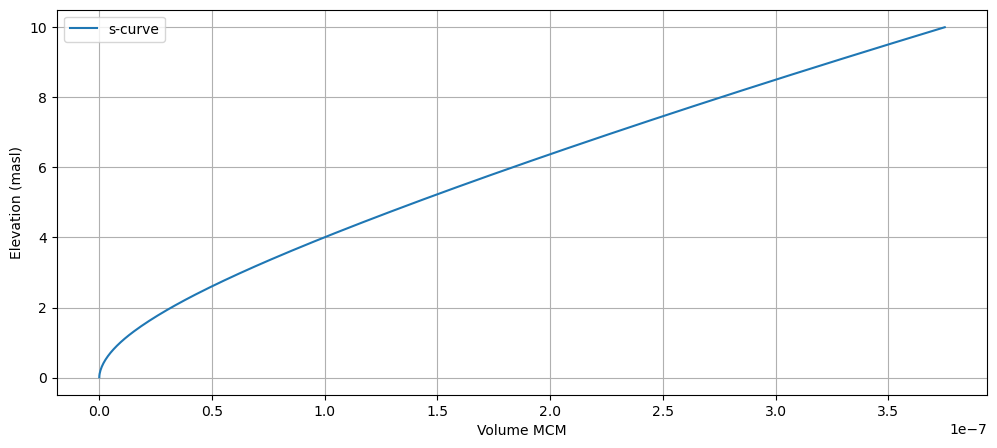

In [32]:
lakeRst = rasterio.open(hand_data)

lakeBottom = hand_map.copy()
lakeBottom[lakeBottom < 0.01] = np.nan
# get raster minimum and maximum 
minElev = np.nanmin(lakeBottom)
maxElev = 10 # flood above 10 m is impossible
#maxElev = np.nanmax(lakeBottom)

# steps for calculation
nSteps = 200

# lake bottom elevation intervals
elevSteps = np.round(np.linspace(minElev,maxElev,nSteps),2)

# definition of volume function
def calculateVol(elevStep,elevDem,lakeRst):
    tempDem = elevStep - elevDem[elevDem<elevStep]
    tempVol = tempDem.sum()*lakeRst.res[0]*lakeRst.res[1]
    return tempVol

# calculate volumes for each elevation
volArray = []

for elev in elevSteps:
    tempVol = calculateVol(elev,lakeBottom,lakeRst)
    volArray.append(tempVol)

volArrayMCM = [x / 10.**6 for x in volArray]

# plot values
fig, ax = plt.subplots(figsize=(12,5))
ax.plot(volArrayMCM,elevSteps,label='s-curve')
ax.grid()
ax.legend()
ax.set_xlabel('Volume MCM')
ax.set_ylabel('Elevation (masl)')
plt.show()

In [27]:
# Retrieving and preparing the data
hand = "hand_cleaned.tiff"
hand_data = pathlib.Path(data_folder, hand)
hand_grid = Grid.from_raster(hand_data.as_posix())
hand_raster = np.flipud(hand_grid.read_raster(hand_data.as_posix()))
hand_raster[hand_raster < 0] = np.nan
hand_view = hand_grid.view(hand_raster, no_data=np.nan)

TOOLTIPS = [("value", "@image")]
# Setting up the Bokeh figure with a background map
p = figure(x_axis_type="mercator", y_axis_type="mercator", tooltips=TOOLTIPS, width = 800, height = 800)
p.add_tile("CartoDB Positron", retina=True)

# Setting the extent in mercator coordinates
gridl1 = wgs84_to_web_mercator(grid.extent[2], grid.extent[0])
gridl2 = wgs84_to_web_mercator(grid.extent[3], grid.extent[1])

# Creating an image of the DEM data
source = ColumnDataSource(data=dict(image=[hand_view], hand_view=[hand_view]))
color = LinearColorMapper(palette = floodmaps_palette, low = -10, high = 200, nan_color='#00000000')
dem_image = p.image(
    image='image',
    source=source,
    x=gridl1[0],
    y=gridl1[1],
    dw=gridl2[0] - gridl1[0],
    dh=gridl2[1] - gridl1[1],
    alpha=0.5,
    level="image",
    color_mapper=color
)
# Create a color bar from the scatter glyph renderer
color_bar = dem_image.construct_color_bar(width=10)
# color_bar = ColorBar(color_mapper = color, location = (0,0))

# Adding callback code
update_image = CustomJS(args=dict(source=source),
                    code="""
    console.log(cb_obj)
    const data = source.data;
    const val = cb_obj.value
    const hand_view = data['hand_view']
    const image = data['image']
    for (let i = 0; i < hand_view[0].length; i++) {
        image[0][i] = val > hand_view[0][i] && hand_view[0][i] ? -10 : hand_view[0][i]
    }
    source.change.emit()
""")

# Creating the slider to slide through the years
time_slider = Slider(title="Height", start=0, end=10, value=0, step=0.1)
time_slider.js_on_change('value', update_image)

p.add_layout(color_bar, 'right')

show(column(p, time_slider))

# Combination between coastal and fluvial flood


Note that in real case, a proper statistical analysis need to be done on compound flooding

In [29]:
TOOLTIPS = [("value", "@image")]
# Setting up the Bokeh figure with a background map
p = figure(x_axis_type="mercator", y_axis_type="mercator", tooltips=TOOLTIPS, width = 800, height = 800)
p.add_tile("CartoDB Positron", retina=True)

# Setting the extent in mercator coordinates
gridl1 = wgs84_to_web_mercator(grid.extent[2], grid.extent[0])
gridl2 = wgs84_to_web_mercator(grid.extent[3], grid.extent[1])

# Creating an image of the DEM data
source = ColumnDataSource(data=dict(image=[dem_view], hand_view=[hand_view], dem_view=[dem_view]))
color = LinearColorMapper(palette = floodmaps_palette, low = -10, high = 200, nan_color='#00000000')
dem_image = p.image(
    image='image',
    source=source,
    x=gridl1[0],
    y=gridl1[1],
    dw=gridl2[0] - gridl1[0],
    dh=gridl2[1] - gridl1[1],
    alpha=0.5,
    level="image",
    color_mapper=color
)
# Create a color bar from the scatter glyph renderer
color_bar = dem_image.construct_color_bar(width=10)
# color_bar = ColorBar(color_mapper = color, location = (0,0))

# Creating the slider to slide through the years
coastal_slider = Slider(title="Coastal flood height", start=0, end=10, value=0, step=0.1)
fluvial_slider = Slider(title="Fluvial flood height", start=0, end=10, value=0, step=0.1)

# Adding callback code
update_compound = CustomJS(args=dict(source=source, coastal_slider=coastal_slider, fluvial_slider=fluvial_slider),
                    code="""
    const data = source.data;
    const coastal_fl = coastal_slider.value
    const fluvial_fl = fluvial_slider.value
    const hand_view = data['hand_view']
    const dem_view = data['dem_view']
    const image = data['image']
    for (let i = 0; i < hand_view[0].length; i++) {
        const coastal = coastal_fl > dem_view[0][i] && dem_view[0][i]
        const fluvial = fluvial_fl > hand_view[0][i] && hand_view[0][i]
        image[0][i] = coastal || fluvial ? -10 : dem_view[0][i]
    }
    source.change.emit()
""")

coastal_slider.js_on_change('value', update_compound)
fluvial_slider.js_on_change('value', update_compound)

p.add_layout(color_bar, 'right')

show(column(p, coastal_slider, fluvial_slider))